<a href="https://colab.research.google.com/github/kellsakf/BDA601-Assessment-2/blob/main/DataStorm2024.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **SAS Hackathon - Moonlight Team**

DataStorm2024 Plastic contaimination analysis
BY Sabrina Fu A00038371 sabrina.fu@business.torrens.edu.au

1. Data Preparation & EDA eda exploratory data analysis

In [50]:
!pip install pandas openpyxl
import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [49]:
#Load Excel file
from google.colab import files
upload = files.upload()

# Extract the filename from the uploaded dictionary
filename = next(iter(upload))
AusMap_df = pd.read_excel(filename)


Saving AusMap DataStorm2024 Data V2.xlsx to AusMap DataStorm2024 Data V2 (1).xlsx


In [56]:
#Display Excel file
pd.set_option('display.max_columns', None) # Show all columns
pd.set_option('display.width', 1000) # Set a large width to prevent wrapping

print(AusMap_df.head(50))

                               RecordID     location       date  latitude   longitude organisation group     PlasticType       Colour Size      Shape  amount  Total Sampled     Per Sqm                 comments      date_sas
0    44091-2020.0000+9.0000=-35.28728_1  Acton Beach 2020-09-17 -35.28728  149.124706      AUSMAP      1            Film        White   >5  Irregular     1.0            328  437.333333                    Fresh  09172020D10.
1    44091-2020.0000+9.0000=-35.28728_2  Acton Beach 2020-09-17 -35.28728  149.124706      AUSMAP      1            Film        White  3-5  Irregular     1.0            328  437.333333                    Fresh  09172020D10.
2    44091-2020.0000+9.0000=-35.28728_3  Acton Beach 2020-09-17 -35.28728  149.124706      AUSMAP      2            Film         Blue   <3  Irregular     1.0            328  437.333333                      NaN  09172020D10.
3    44091-2020.0000+9.0000=-35.28728_4  Acton Beach 2020-09-17 -35.28728  149.124706      AUSMAP      2

In [57]:
# check df data type and null value

print(AusMap_df.info())
print(AusMap_df.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25054 entries, 0 to 25053
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   RecordID       25054 non-null  object        
 1   location       25054 non-null  object        
 2   date           25054 non-null  datetime64[ns]
 3   latitude       25054 non-null  float64       
 4   longitude      25054 non-null  float64       
 5   organisation   25028 non-null  object        
 6   group          24433 non-null  object        
 7   PlasticType    25053 non-null  object        
 8   Colour         24770 non-null  object        
 9   Size           25054 non-null  object        
 10  Shape          25054 non-null  object        
 11  amount         25053 non-null  float64       
 12  Total Sampled  25054 non-null  int64         
 13  Per Sqm        25054 non-null  float64       
 14  comments       6267 non-null   object        
 15  date_sas       2505

Convert Date format to SAS format

In [59]:
# Convert 'date' column to datetime objects if it's not already
AusMap_df['date'] = pd.to_datetime(AusMap_df['date'])

# Convert to SAS format MMDDYYD10
AusMap_df['date_sas'] = AusMap_df['date'].dt.strftime('%m%d%y')

#Replace the 'date' column with 'date_sas'
AusMap_df = AusMap_df.drop('date', axis=1)
print(AusMap_df.head(50))

                               RecordID     location  latitude   longitude organisation group     PlasticType       Colour Size      Shape  amount  Total Sampled     Per Sqm                 comments date_sas
0    44091-2020.0000+9.0000=-35.28728_1  Acton Beach -35.28728  149.124706      AUSMAP      1            Film        White   >5  Irregular     1.0            328  437.333333                    Fresh   091720
1    44091-2020.0000+9.0000=-35.28728_2  Acton Beach -35.28728  149.124706      AUSMAP      1            Film        White  3-5  Irregular     1.0            328  437.333333                    Fresh   091720
2    44091-2020.0000+9.0000=-35.28728_3  Acton Beach -35.28728  149.124706      AUSMAP      2            Film         Blue   <3  Irregular     1.0            328  437.333333                      NaN   091720
3    44091-2020.0000+9.0000=-35.28728_4  Acton Beach -35.28728  149.124706      AUSMAP      2            Film        Green   <3    Angular     1.0            328  437.3

SAVE the updated data file with correct date format

In [60]:
#save the above amended dataframe as .xlsx to local drive

from google.colab import files
AusMap_df.to_excel('amended_dataframe.xlsx', index=False)
files.download('amended_dataframe.xlsx')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

HeatMap

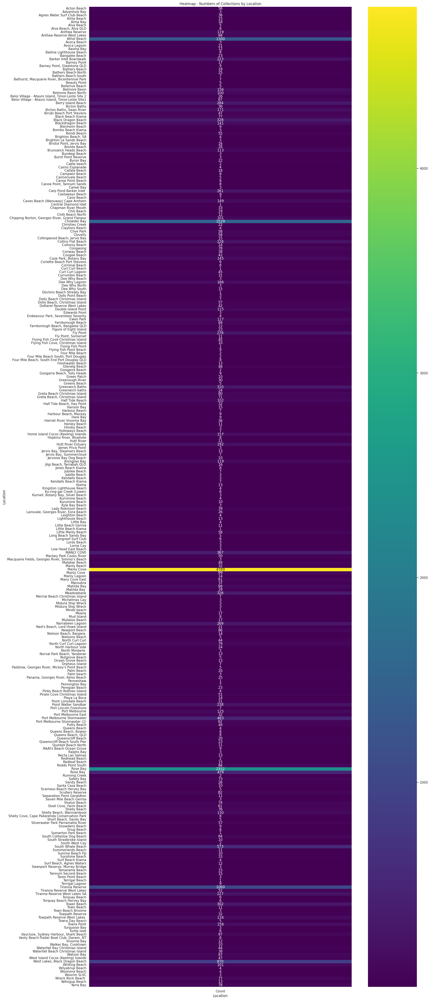

In [61]:
#heatmap with most location counts

location_counts = AusMap_df['location'].value_counts()

# Create a DataFrame for the heatmap
heatmap_df = pd.DataFrame({'location': location_counts.index, 'Count': location_counts.values})

# Create the heatmap
plt.figure(figsize=(20, 60))  # Adjust figure size
sns.heatmap(heatmap_df.pivot_table(index='location', values='Count'), annot=True, cmap='viridis', fmt='g')
plt.title('Heatmap - Numbers of Collections by Location')
plt.xlabel('Location')
plt.ylabel('Location')
plt.show()

In [62]:
print(len(location_counts))  #Number of Locations

290


highest number of Per Sqm based on 'location'

In [65]:
# Group by 'location' and find the maximum 'Per Sqm' for each location
max_per_sqm_by_location = AusMap_df.groupby('location')['Per Sqm'].max()

# Find the location with the highest maximum 'Per Sqm'
location_with_highest_per_sqm = max_per_sqm_by_location.idxmax()

# Print the result
print(f"The location with the highest 'Per Sqm' is: {location_with_highest_per_sqm}")
print(f"The highest 'Per Sqm' value is: {max_per_sqm_by_location.max()}")

The location with the highest 'Per Sqm' is: Carp Pond Barker Inlet 
The highest 'Per Sqm' value is: 531100.0


Correlation Matrix

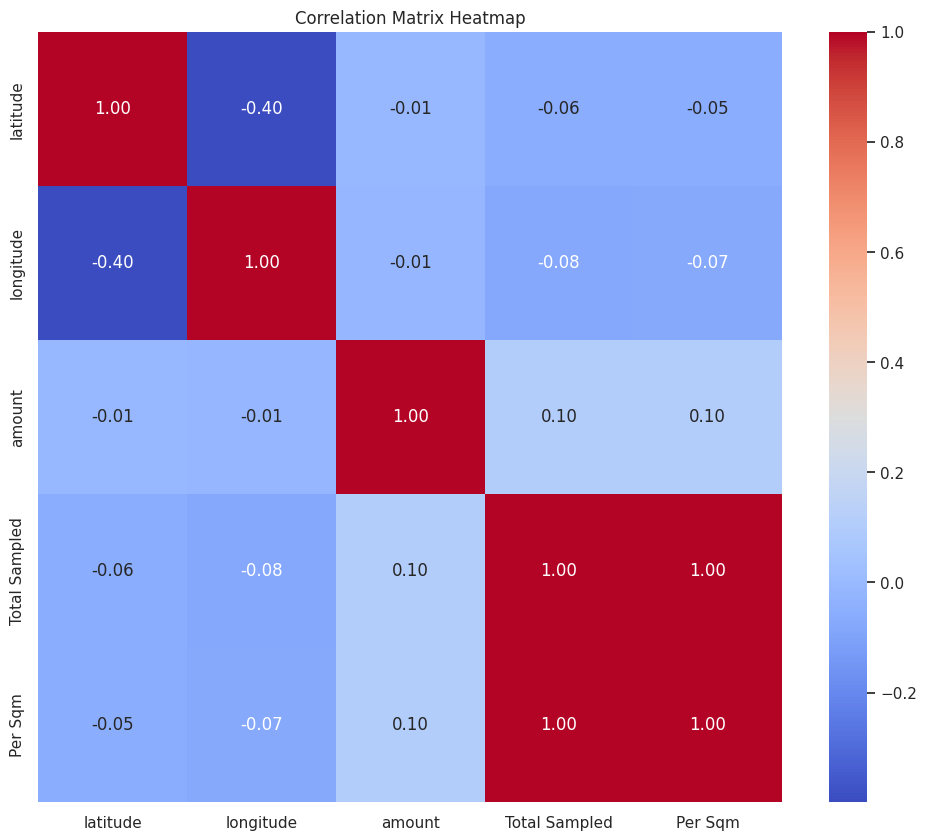

In [63]:
# Select numerical features for correlation analysis
numerical_features = AusMap_df.select_dtypes(include=np.number)

# Calculate the correlation matrix
correlation_matrix = numerical_features.corr()

# Create the heatmap
plt.figure(figsize=(12, 10))  # Adjust figure size as needed
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix Heatmap')
plt.show()

PROC TIMESERIES linear regression to perform time series analysis for each location and analyse how Total Sampled and Per Sqm vary over time

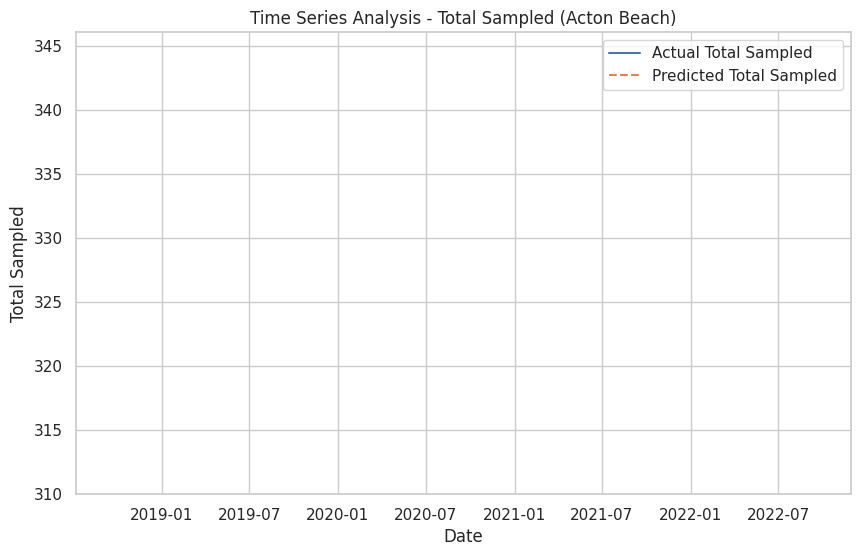

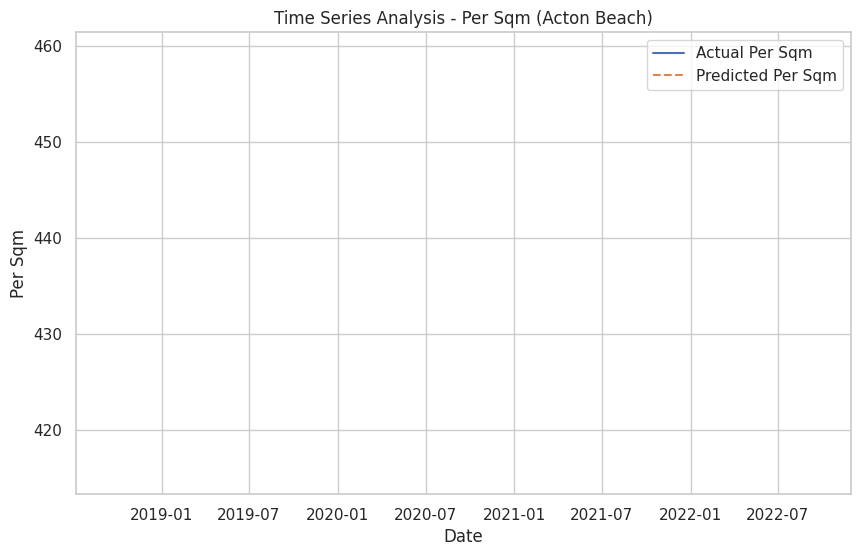

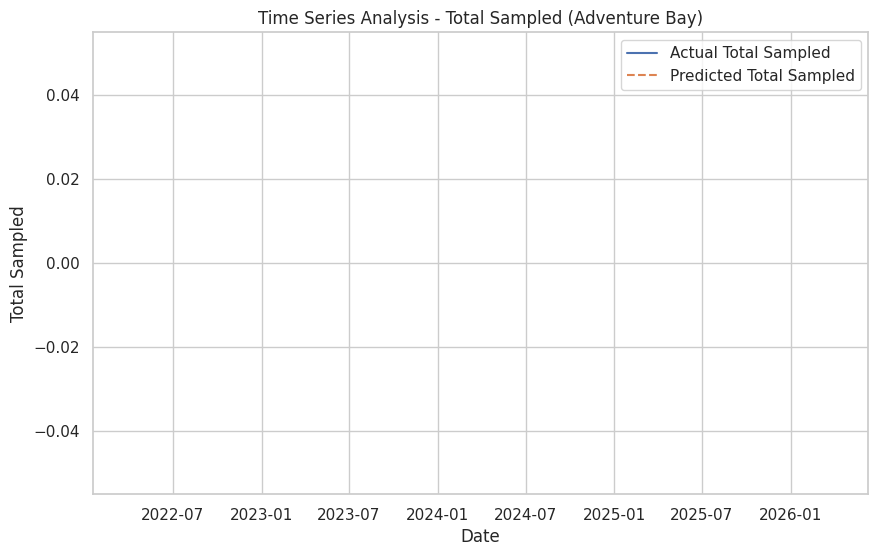

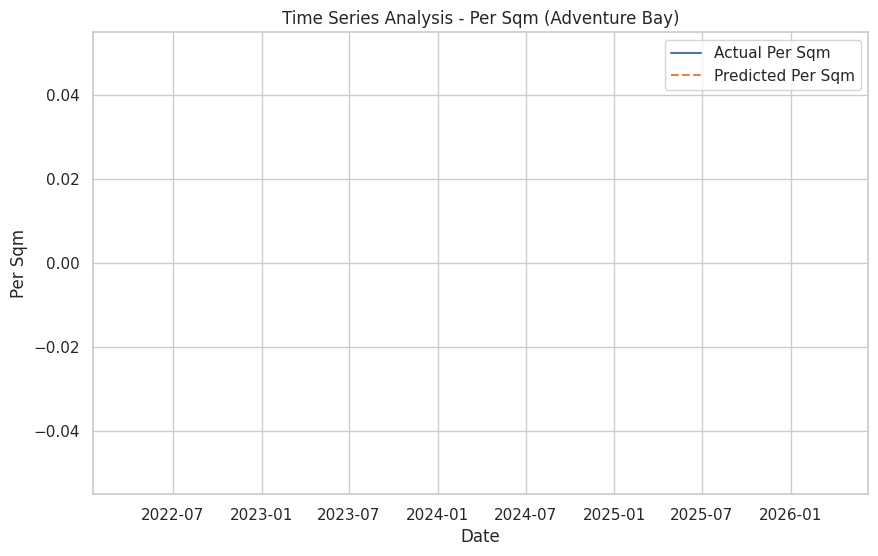

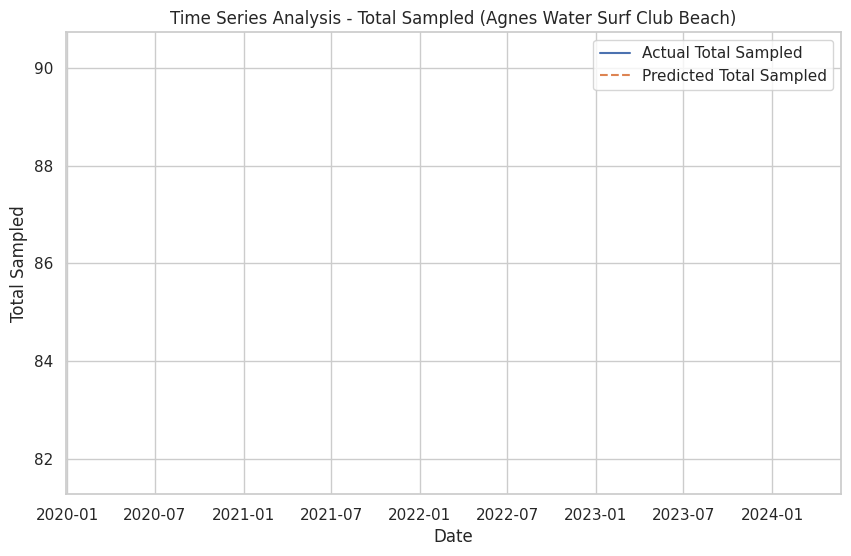

...

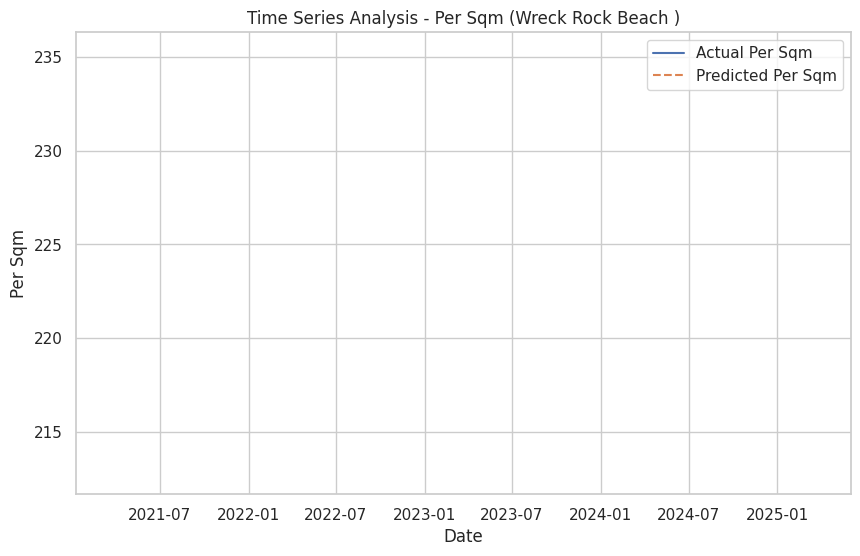

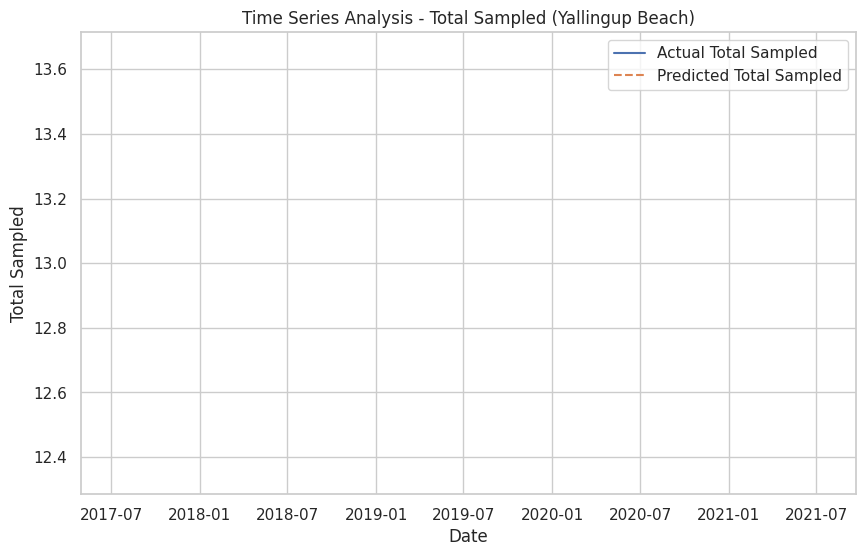

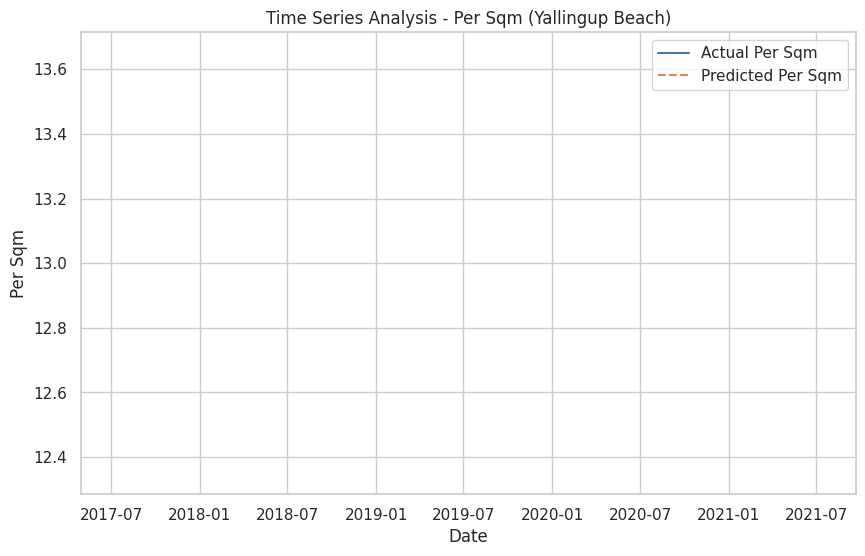

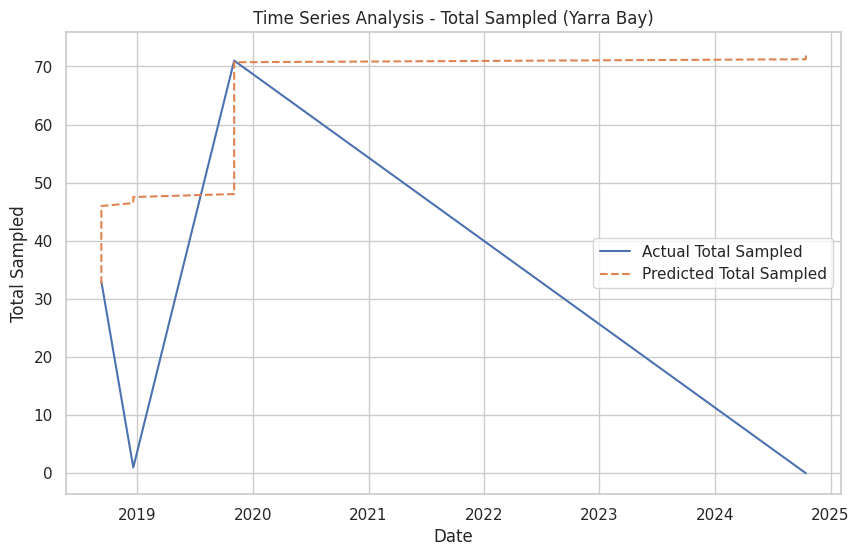

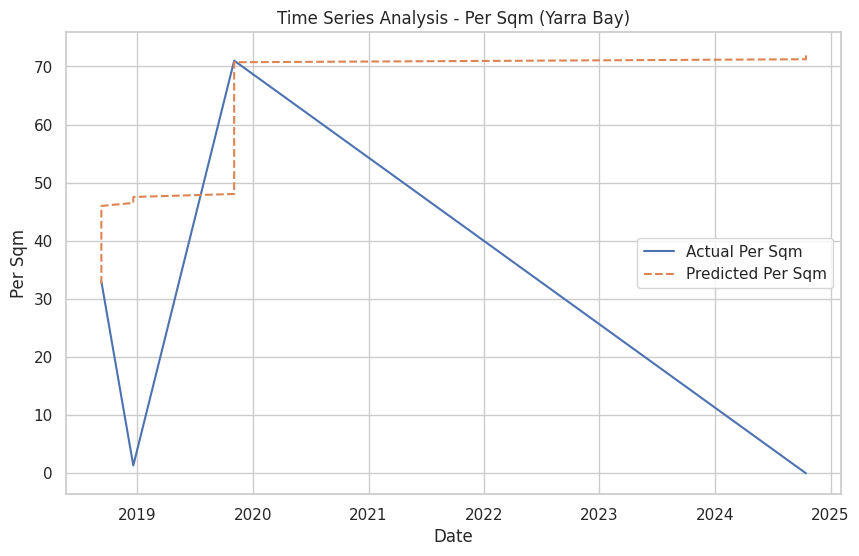

In [64]:
#PROC TIMESERIES linear regression to perform time series analysis for each location and analyse how Total Sampled and Per Sqm vary over time
# Convert 'date_sas' to datetime objects
AusMap_df['date_sas'] = pd.to_datetime(AusMap_df['date_sas'], format='%m%d%y')

# Group data by location
grouped = AusMap_df.groupby('location')

# Iterate through each location and perform time series analysis
for location, group_df in grouped:
    # Sort by date
    group_df = group_df.sort_values(by='date_sas')

    # Example: Linear Regression for 'Total Sampled'
    # Prepare data
    X = np.arange(len(group_df)).reshape(-1,1)  # Time index
    y_total = group_df['Total Sampled']

    # Perform linear regression
    from sklearn.linear_model import LinearRegression
    model_total = LinearRegression().fit(X, y_total)

    # Predict values
    y_pred_total = model_total.predict(X)

    # Plot the results for 'Total Sampled'
    plt.figure(figsize=(10, 6))
    plt.plot(group_df['date_sas'], y_total, label='Actual Total Sampled')
    plt.plot(group_df['date_sas'], y_pred_total, label='Predicted Total Sampled', linestyle='--')
    plt.title(f'Time Series Analysis - Total Sampled ({location})')
    plt.xlabel('Date')
    plt.ylabel('Total Sampled')
    plt.legend()
    plt.show()

    #Linear Regression for 'Per Sqm'
    y_sqm = group_df['Per Sqm']
    model_sqm = LinearRegression().fit(X, y_sqm)
    y_pred_sqm = model_sqm.predict(X)

    # Plot the results for 'Per Sqm'
    plt.figure(figsize=(10, 6))
    plt.plot(group_df['date_sas'], y_sqm, label='Actual Per Sqm')
    plt.plot(group_df['date_sas'], y_pred_sqm, label='Predicted Per Sqm', linestyle='--')
    plt.title(f'Time Series Analysis - Per Sqm ({location})')
    plt.xlabel('Date')
    plt.ylabel('Per Sqm')
    plt.legend()
    plt.show()